In [30]:
import os
import random
import warnings

import cv2
import gdown
from functools import partial

warnings.simplefilter(action="ignore")
os.environ["TF_CPP_MIN_LOG_LEVEL"] = "3"
os.environ["XLA_PYTHON_CLIENT_PREALLOCATE"] = "false"

import numpy as np
import pandas as pd
from matplotlib import cm
from numpy.random import rand
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import backend
from tensorflow.keras import layers
from tensorflow.keras.preprocessing.image import ImageDataGenerator

physical_devices = tf.config.list_physical_devices("GPU")
try:
    tf.config.experimental.set_memory_growth(physical_devices[0], True)
    tf.config.optimizer.set_jit(True)
    keras.mixed_precision.set_global_policy("mixed_float16")
except:
    pass

seed = 1337
tf.random.set_seed(seed)

In [31]:
def get_model_weight(model_id):
    """Get the trained weights."""
    if not os.path.exists("model.h5"):
        model_weight = gdown.download(id=model_id, quiet=False)
    else:
        model_weight = "model.h5"
    return model_weight


def get_model_history(history_id):
    """Get the history / log file."""
    if not os.path.exists("history.csv"):
        history_file = gdown.download(id=history_id, quiet=False)
    else:
        history_file = "history.csv"
    return history_file


def make_plot(tfdata, take_batch=1, title=True, figsize=(20, 20)):
    """ref: https://gist.github.com/innat/4dc4080cfdf5cf20ef0fc93d3623ca9b"""

    font = {
        "family": "serif",
        "color": "darkred",
        "weight": "normal",
        "size": 15,
    }

    for images, labels in tfdata.take(take_batch):
        plt.figure(figsize=figsize)
        xy = int(np.ceil(images.shape[0] * 0.5))

        for i in range(images.shape[0]):
            plt.subplot(xy, xy, i + 1)
            plt.imshow(tf.cast(images[i], dtype=tf.uint8))
            if title:
                plt.title(tcls_names[tf.argmax(labels[i], axis=-1)], fontdict=font)
            plt.axis("off")

    plt.tight_layout()
    plt.show()

In [32]:
train_dir = "F:/WBC/WBC/train"
val_dir = "F:/WBC/WBC/val"
test_dir = "F:/WBC/WBC/test"

datagen_train = ImageDataGenerator(rescale=1./255,
                                  width_shift_range=0.1,
                                  height_shift_range=0.1,
                                  horizontal_flip=True,
                                  vertical_flip=False)

datagen_val = ImageDataGenerator(rescale=1./255)


datagen_test = ImageDataGenerator(rescale=1./255)


batch_size = 16
generator_train = datagen_train.flow_from_directory(directory=train_dir,
                                                    target_size=(384, 384),
                                                    batch_size=batch_size,
                                                    shuffle=True)

generator_val = datagen_test.flow_from_directory(directory=val_dir,
                                                  target_size=(384, 384),
                                                  batch_size=batch_size,
                                                  shuffle=False)

generator_test = datagen_train.flow_from_directory(directory=test_dir,
                                                    target_size=(384, 384),
                                                    batch_size=batch_size,
                                                    shuffle=False)

Found 2043 images belonging to 10 classes.
Found 675 images belonging to 10 classes.
Found 675 images belonging to 10 classes.


In [33]:
class Parameters:
    # data level
    image_size = 384
    batch_size = 4
    num_grad_accumulation = 8
    label_smooth=0.05
    class_number = 10
    val_split = 0.4 
    verbosity = 2
    autotune = tf.data.AUTOTUNE
    
    # hparams
    epochs = 50
    lr_sched = 'cosine_restart' # [or, exponential, cosine, linear, constant]
    lr_base  = 0.016
    lr_min   = 0
    lr_decay_epoch  = 2.4
    lr_warmup_epoch = 5
    lr_decay_factor = 0.97
    
    scaled_lr = lr_base * (batch_size / 256.0)
    scaled_lr_min = lr_min * (batch_size / 256.0)
    #num_validation_sample = int(image_count * val_split)
    #num_training_sample = image_count - num_validation_sample
    #train_step = int(np.ceil(num_training_sample / float(batch_size)))
    #total_steps = train_step * epochs

params = Parameters()

In [34]:
patch_size      = (2,2)   # 2-by-2 sized patches
dropout_rate    = 0.5     # Dropout rate
num_heads       = 8       # Attention heads
embed_dim       = 64      # Embedding dimension
num_mlp         = 128     # MLP layer size
qkv_bias        = True    # Convert embedded patches to query, key, and values
window_size     = 2       # Size of attention window
shift_size      = 1       # Size of shifting window
image_dimension = 24      # Initial image size / Input size of the transformer model 

num_patch_x = image_dimension // patch_size[0]
num_patch_y = image_dimension // patch_size[1]

In [35]:
def window_partition(x, window_size):
    _, height, width, channels = x.shape
    patch_num_y = height // window_size
    patch_num_x = width // window_size
    x = tf.reshape(
        x, shape=(-1, patch_num_y, window_size, patch_num_x, window_size, channels)
    )
    x = tf.transpose(x, (0, 1, 3, 2, 4, 5))
    windows = tf.reshape(x, shape=(-1, window_size, window_size, channels))
    return windows


def window_reverse(windows, window_size, height, width, channels):
    patch_num_y = height // window_size
    patch_num_x = width // window_size
    x = tf.reshape(
        windows,
        shape=(-1, patch_num_y, patch_num_x, window_size, window_size, channels),
    )
    x = tf.transpose(x, perm=(0, 1, 3, 2, 4, 5))
    x = tf.reshape(x, shape=(-1, height, width, channels))
    return x


class DropPath(layers.Layer):
    def __init__(self, drop_prob=None, **kwargs):
        super(DropPath, self).__init__(**kwargs)
        self.drop_prob = drop_prob

    def call(self, inputs, training=None):
        if self.drop_prob == 0.0 or not training:
            return inputs
        else:
            batch_size = tf.shape(inputs)[0]
            keep_prob = 1 - self.drop_prob
            path_mask_shape = (batch_size,) + (1,) * (len(tf.shape(inputs)) - 1)
            path_mask = tf.floor(
                backend.random_bernoulli(path_mask_shape, p=keep_prob)
            )
            outputs = (
                tf.math.divide(tf.cast(inputs, dtype=tf.float32), keep_prob) * path_mask
            )
            return outputs

    def get_config(self):
        config = super().get_config()
        config.update(
            {
                "drop_prob": self.drop_prob,
            }
        )
        return config

In [36]:
class PatchExtract(layers.Layer):
    def __init__(self, patch_size, **kwargs):
        super().__init__(**kwargs)
        self.patch_size_x = patch_size[0]
        self.patch_size_y = patch_size[0]

    def call(self, images):
        batch_size = tf.shape(images)[0]
        patches = tf.image.extract_patches(
            images=images,
            sizes=(1, self.patch_size_x, self.patch_size_y, 1),
            strides=(1, self.patch_size_x, self.patch_size_y, 1),
            rates=(1, 1, 1, 1),
            padding="VALID",
        )
        patch_dim = patches.shape[-1]
        patch_num = patches.shape[1]
        return tf.reshape(patches, (batch_size, patch_num * patch_num, patch_dim))

    def get_config(self):
        config = super().get_config()
        config.update(
            {
                "patch_size_y": self.patch_size_y,
                "patch_size_x": self.patch_size_x,
            }
        )
        return config


class PatchEmbedding(layers.Layer):
    def __init__(self, num_patch, embed_dim, **kwargs):
        super().__init__(**kwargs)
        self.num_patch = num_patch
        self.proj = layers.Dense(embed_dim)
        self.pos_embed = layers.Embedding(input_dim=num_patch, output_dim=embed_dim)

    def call(self, patch):
        pos = tf.range(start=0, limit=self.num_patch, delta=1)
        return self.proj(patch) + self.pos_embed(pos)

    def get_config(self):
        config = super().get_config()
        config.update(
            {
                "num_patch": self.num_patch,
            }
        )
        return config


class PatchMerging(layers.Layer):
    def __init__(self, num_patch, embed_dim):
        super().__init__()
        self.num_patch = num_patch
        self.embed_dim = embed_dim
        self.linear_trans = layers.Dense(2 * embed_dim, use_bias=False)

    def call(self, x):
        height, width = self.num_patch
        _, _, C = x.get_shape().as_list()
        x = tf.reshape(x, shape=(-1, height, width, C))
        feat_maps = x

        x0 = x[:, 0::2, 0::2, :]
        x1 = x[:, 1::2, 0::2, :]
        x2 = x[:, 0::2, 1::2, :]
        x3 = x[:, 1::2, 1::2, :]
        x = tf.concat((x0, x1, x2, x3), axis=-1)
        x = tf.reshape(x, shape=(-1, (height // 2) * (width // 2), 4 * C))
        return self.linear_trans(x), feat_maps

    def get_config(self):
        config = super().get_config()
        config.update({"num_patch": self.num_patch, "embed_dim": self.embed_dim})
        return config

In [37]:
class WindowAttention(layers.Layer):
    def __init__(
        self,
        dim,
        window_size,
        num_heads,
        qkv_bias=True,
        dropout_rate=0.0,
        return_attention_scores=False,
        **kwargs
    ):
        super().__init__(**kwargs)
        self.dim = dim
        self.window_size = window_size
        self.num_heads = num_heads
        self.scale = (dim // num_heads) ** -0.5
        self.return_attention_scores = return_attention_scores
        self.qkv = layers.Dense(dim * 3, use_bias=qkv_bias)
        self.dropout = layers.Dropout(dropout_rate)
        self.proj = layers.Dense(dim)

    def build(self, input_shape):
        self.relative_position_bias_table = self.add_weight(
            shape=(
                (2 * self.window_size[0] - 1) * (2 * self.window_size[1] - 1),
                self.num_heads,
            ),
            initializer="zeros",
            trainable=True,
            name="relative_position_bias_table",
        )

        self.relative_position_index = self.get_relative_position_index(
            self.window_size[0], self.window_size[1]
        )
        super().build(input_shape)

    def get_relative_position_index(self, window_height, window_width):
        x_x, y_y = tf.meshgrid(range(window_height), range(window_width))
        coords = tf.stack([y_y, x_x], axis=0)
        coords_flatten = tf.reshape(coords, [2, -1])

        relative_coords = coords_flatten[:, :, None] - coords_flatten[:, None, :]
        relative_coords = tf.transpose(relative_coords, perm=[1, 2, 0])

        x_x = (relative_coords[:, :, 0] + window_height - 1) * (2 * window_width - 1)
        y_y = relative_coords[:, :, 1] + window_width - 1
        relative_coords = tf.stack([x_x, y_y], axis=-1)

        return tf.reduce_sum(relative_coords, axis=-1)

    def call(self, x, mask=None):
        _, size, channels = x.shape
        head_dim = channels // self.num_heads
        x_qkv = self.qkv(x)
        x_qkv = tf.reshape(x_qkv, shape=(-1, size, 3, self.num_heads, head_dim))
        x_qkv = tf.transpose(x_qkv, perm=(2, 0, 3, 1, 4))
        q, k, v = x_qkv[0], x_qkv[1], x_qkv[2]
        q = q * self.scale
        k = tf.transpose(k, perm=(0, 1, 3, 2))
        attn = q @ k

        relative_position_bias = tf.gather(
            self.relative_position_bias_table,
            self.relative_position_index,
            axis=0,
        )
        relative_position_bias = tf.transpose(relative_position_bias, [2, 0, 1])
        attn = attn + tf.expand_dims(relative_position_bias, axis=0)

        if mask is not None:
            nW = mask.get_shape()[0]
            mask_float = tf.cast(
                tf.expand_dims(tf.expand_dims(mask, axis=1), axis=0), tf.float32
            )
            attn = (
                tf.reshape(attn, shape=(-1, nW, self.num_heads, size, size))
                + mask_float
            )
            attn = tf.reshape(attn, shape=(-1, self.num_heads, size, size))
            attn = tf.nn.softmax(attn, axis=-1)
        else:
            attn = tf.nn.softmax(attn, axis=-1)
        attn = self.dropout(attn)

        x_qkv = attn @ v
        x_qkv = tf.transpose(x_qkv, perm=(0, 2, 1, 3))
        x_qkv = tf.reshape(x_qkv, shape=(-1, size, channels))
        x_qkv = self.proj(x_qkv)
        x_qkv = self.dropout(x_qkv)

        if self.return_attention_scores:
            return x_qkv, attn
        else:
            return x_qkv

    def get_config(self):
        config = super().get_config()
        config.update(
            {
                "dim": self.dim,
                "window_size": self.window_size,
                "num_heads": self.num_heads,
                "scale": self.scale,
            }
        )
        return config

In [38]:
class SwinTransformer(layers.Layer):
    def __init__(
        self, 
        dim,
        num_patch,
        num_heads,
        window_size=7,
        shift_size=0,
        num_mlp=1024,
        qkv_bias=True,
        dropout_rate=0.0,
        **kwargs,
    ):
        super(SwinTransformer, self).__init__(**kwargs)

        self.dim = dim 
        self.num_patch = num_patch  
        self.num_heads = num_heads 
        self.window_size = window_size  
        self.shift_size = shift_size  
        self.num_mlp = num_mlp  

        self.norm1 = layers.LayerNormalization(epsilon=1e-5)
        self.attn = WindowAttention(
            dim,
            window_size=(self.window_size, self.window_size),
            num_heads=num_heads,
            qkv_bias=qkv_bias,
            dropout_rate=dropout_rate,
        )
        self.drop_path = (
            DropPath(dropout_rate) if dropout_rate > 0.0 else tf.identity
        )
        self.norm2 = layers.LayerNormalization(epsilon=1e-5)

        self.mlp = keras.Sequential(
            [
                layers.Dense(num_mlp),
                layers.Activation(keras.activations.gelu),
                layers.Dropout(dropout_rate),
                layers.Dense(dim),
                layers.Dropout(dropout_rate),
            ]
        )

        if min(self.num_patch) < self.window_size:
            self.shift_size = 0
            self.window_size = min(self.num_patch)

    def build(self, input_shape):
        if self.shift_size == 0:
            self.attn_mask = None
        else:
            height, width = self.num_patch
            h_slices = (
                slice(0, -self.window_size),
                slice(-self.window_size, -self.shift_size),
                slice(-self.shift_size, None),
            )
            w_slices = (
                slice(0, -self.window_size),
                slice(-self.window_size, -self.shift_size),
                slice(-self.shift_size, None),
            )
            mask_array = jnp.zeros((1, height, width, 1))
            count = 0
            for h in h_slices:
                for w in w_slices:
                    mask_array[:, h, w, :] = count
                    count += 1
            mask_array = tf.convert_to_tensor(mask_array)

            # mask array to windows
            mask_windows = window_partition(mask_array, self.window_size)
            mask_windows = tf.reshape(
                mask_windows, shape=[-1, self.window_size * self.window_size]
            )
            attn_mask = tf.expand_dims(mask_windows, axis=1) - tf.expand_dims(
                mask_windows, axis=2
            )
            attn_mask = tf.where(attn_mask != 0, -100.0, attn_mask)
            attn_mask = tf.where(attn_mask == 0, 0.0, attn_mask)
            self.attn_mask = tf.Variable(initial_value=attn_mask, trainable=False)

    def call(self, x):
        height, width = self.num_patch
        _, num_patches_before, channels = x.shape
        x_skip = x
        x = self.norm1(x)
        x = tf.reshape(x, shape=(-1, height, width, channels))
        if self.shift_size > 0:
            shifted_x = tf.roll(
                x, shift=[-self.shift_size, -self.shift_size], axis=[1, 2]
            )
        else:
            shifted_x = x

        x_windows = window_partition(shifted_x, self.window_size)
        x_windows = tf.reshape(
            x_windows, shape=(-1, self.window_size * self.window_size, channels)
        )
        attn_windows = self.attn(x_windows, mask=self.attn_mask)

        attn_windows = tf.reshape(
            attn_windows, shape=(-1, self.window_size, self.window_size, channels)
        )
        shifted_x = window_reverse(
            attn_windows, self.window_size, height, width, channels
        )
        if self.shift_size > 0:
            x = tf.roll(
                shifted_x, shift=[self.shift_size, self.shift_size], axis=[1, 2]
            )
        else:
            x = shifted_x

        x = tf.reshape(x, shape=(-1, height * width, channels))
        x = self.drop_path(x)
        x = tf.cast(x_skip, dtype=tf.float32) + tf.cast(x, dtype=tf.float32)
        x_skip = x
        x = self.norm2(x)
        x = self.mlp(x)
        x = self.drop_path(x)
        x = tf.cast(x_skip, dtype=tf.float32) + tf.cast(x, dtype=tf.float32)
        return x

In [39]:
# base cnn models
base = keras.applications.VGG19(
    include_top=False,
    weights='imagenet',
    input_tensor=keras.Input((params.image_size, params.image_size, 3)),
)

In [40]:
base.summary()

Model: "vgg19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 384, 384, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 384, 384, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 384, 384, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 192, 192, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 192, 192, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 192, 192, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 96, 96, 128)       0     

In [41]:
class HybridModel(keras.Model):
    def __init__(self, model_name, **kwargs):
        super().__init__(name=model_name, **kwargs)

        # base model with compatible output which will be an input of transformer model
        self.multi_output_cnn = keras.Model(
            [base.inputs],
            [base.get_layer("block5_conv4").output, base.output],
            name="VGG19",
        )

        # base model's (cnn model) head
        self.conv_head = keras.Sequential(
            [
                layers.GlobalAveragePooling2D(),
                layers.AlphaDropout(0.5),
            ],
            name="conv_head",
        )

        # stuff of swin transformers
        self.patch_extract = PatchExtract(patch_size)
        self.patch_embedds = PatchEmbedding(num_patch_x * num_patch_y, embed_dim)
        self.patch_merging = PatchMerging(
            (num_patch_x, num_patch_y), embed_dim=embed_dim
        )

        # swin blocks containers
        self.swin_sequences = keras.Sequential(name="swin_blocks")
        for i in range(shift_size):
            self.swin_sequences.add(
                SwinTransformer(
                    dim=embed_dim,
                    num_patch=(num_patch_x, num_patch_y),
                    num_heads=num_heads,
                    window_size=window_size,
                    shift_size=i,
                    num_mlp=num_mlp,
                    qkv_bias=qkv_bias,
                    dropout_rate=dropout_rate,
                )
            )

        # swin block's head
        self.swin_head = keras.Sequential(
            [
                layers.GlobalAveragePooling1D(),
                layers.AlphaDropout(0.5),
                layers.BatchNormalization(),
            ],
            name="swin_head",
        )

        # classifier
        self.classifier = layers.Dense(
            params.class_number, activation=None, dtype="float32"
        )

        # build the graph
        self.build_graph()

    def forward_cnn(self, inputs):
        # CNN model.
        return self.multi_output_cnn(inputs)

    def forward_transformer(self, inputs):
        # Transformer model.
        x = self.patch_extract(inputs)
        x = self.patch_embedds(x)
        x = self.swin_sequences(tf.cast(x, dtype=tf.float32))
        x, swin_gcam_top = self.patch_merging(x)
        return x, swin_gcam_top

    def call(self, inputs, training=None, **kwargs):
        cnn_mid_layer, cnn_gcam_top = self.forward_cnn(inputs)
        transformer_output, transformer_gcam_top = self.forward_transformer(
            cnn_mid_layer
        )

        transformer_output = self.swin_head(transformer_output)
        cnn_output = self.conv_head(cnn_gcam_top)
        logits = self.classifier(tf.concat([transformer_output, cnn_output], axis=-1))

        if training:
            return logits
        else:
            return logits, cnn_gcam_top, transformer_gcam_top

    def build_graph(self):
        x = keras.Input(shape=(params.image_size, params.image_size, 3))
        return keras.Model(inputs=[x], outputs=self.call(x))

In [42]:
class GradientAccumulation(HybridModel):
    """Subclassing the mdoel class to override the train step to 
    implemnet gradient accumulation.
    
    Ref: https://gist.github.com/innat/ba6740293e7b7b227829790686f2119c
    """

    def __init__(self, n_gradients, **kwargs):
        super().__init__(**kwargs)
        self.n_gradients = tf.constant(n_gradients, dtype=tf.int32)
        self.n_acum_step = tf.Variable(0, dtype=tf.int32, trainable=False)
        self.gradient_accumulation = [
            tf.Variable(tf.zeros_like(v, dtype=tf.float32), trainable=False)
            for v in self.trainable_variables
        ]

    def train_step(self, data):
        # track accumulation step update
        self.n_acum_step.assign_add(1)

        # Unpack the data. Its structure depends on your model and
        # on what you pass to `fit()`.
        x, y = data

        with tf.GradientTape() as tape:
            y_pred = self(x, training=True)  # Forward pass
            loss = self.compiled_loss(y, y_pred, regularization_losses=self.losses)

        # Calculate batch gradients
        gradients = tape.gradient(loss, self.trainable_variables)

        # Accumulate batch gradients
        for i in range(len(self.gradient_accumulation)):
            self.gradient_accumulation[i].assign_add(gradients[i])

        # If n_acum_step reach the n_gradients then we apply accumulated gradients to -
        # update the variables otherwise do nothing
        tf.cond(
            tf.equal(self.n_acum_step, self.n_gradients),
            self.apply_accu_gradients,
            lambda: None,
        )

        # Return a dict mapping metric names to current value.
        # Note that it will include the loss (tracked in self.metrics).
        self.compiled_metrics.update_state(y, y_pred)
        return {m.name: m.result() for m in self.metrics}

    def apply_accu_gradients(self):
        # Update weights
        self.optimizer.apply_gradients(
            zip(self.gradient_accumulation, self.trainable_variables)
        )

        # reset accumulation step
        self.n_acum_step.assign(0)
        for i in range(len(self.gradient_accumulation)):
            self.gradient_accumulation[i].assign(
                tf.zeros_like(self.trainable_variables[i], dtype=tf.float32)
            )

    def test_step(self, data):
        # Unpack the data
        x, y = data

        # Compute predictions
        y_pred, base_gcam_top, swin_gcam_top = self(x, training=False)

        # Updates the metrics tracking the loss
        self.compiled_loss(y, y_pred, regularization_losses=self.losses)

        # Update the metrics.
        self.compiled_metrics.update_state(y, y_pred)

        # Return a dict mapping metric names to current value.
        # Note that it will include the loss (tracked in self.metrics).
        return {m.name: m.result() for m in self.metrics}

In [43]:
def get_model(plot_summary=False, plot_graph=False):
    keras.backend.clear_session()
    model = GradientAccumulation(
        n_gradients=params.num_grad_accumulation, model_name="HybridModel"
    )

    if plot_summary:
        display(
            model.build_graph().summary()
        )

    if plot_graph:
        display(
            keras.utils.plot_model(
                model.build_graph(),
                show_shapes=True,
                show_layer_names=True,
                expand_nested=False,
            )
        )

    # compile
    model.compile(
        loss=losses.CategoricalCrossentropy(
            label_smoothing=params.label_smooth, from_logits=True
        ),
        optimizer=optimizers.Adam(learning_rate, amsgrad=True),
        metrics=["accuracy"],
    )
    return model

In [44]:
from tensorflow.keras import losses
from tensorflow.keras import metrics
from tensorflow.keras import callbacks
from tensorflow.keras import optimizers

ckp = callbacks.ModelCheckpoint(
    "model.h5",
    monitor="val_accuracy",
    verbose=1,
    save_best_only=True,
    save_weights_only=True,
    mode="max",
)
log = callbacks.CSVLogger("history.csv", separator=",", append=False)

In [45]:
class WarmupLearningRateSchedule(optimizers.schedules.LearningRateSchedule):
    """WarmupLearningRateSchedule a variety of learning rate
    decay schedules with warm up.
    
    Ref. https://gist.github.com/innat/69e8f3500c2418c69b150a0a651f31dc
    """

    def __init__(
        self,
        initial_lr,
        steps_per_epoch=None,
        lr_decay_type="exponential",
        decay_factor=0.97,
        decay_epochs=2.4,
        total_steps=None,
        warmup_epochs=5,
        minimal_lr=0, 
        **kwargs
    ):
        super().__init__(**kwargs)
        self.initial_lr = initial_lr
        self.steps_per_epoch = steps_per_epoch
        self.lr_decay_type = lr_decay_type
        self.decay_factor = decay_factor
        self.decay_epochs = decay_epochs
        self.total_steps = total_steps
        self.warmup_epochs = warmup_epochs
        self.minimal_lr = minimal_lr

    def __call__(self, step):
        if self.lr_decay_type == "exponential":
            assert self.steps_per_epoch is not None
            decay_steps = self.steps_per_epoch * self.decay_epochs
            lr = schedules.ExponentialDecay(
                self.initial_lr, decay_steps, self.decay_factor, staircase=True
            )(step)
            
        elif self.lr_decay_type == "cosine":
            assert self.total_steps is not None
            lr = (
                0.5
                * self.initial_lr
                * (1 + tf.cos(np.pi * tf.cast(step, tf.float32) / self.total_steps))
            )

        elif self.lr_decay_type == "linear":
            assert self.total_steps is not None
            lr = (1.0 - tf.cast(step, tf.float32) / self.total_steps) * self.initial_lr

        elif self.lr_decay_type == "constant":
            lr = self.initial_lr

        elif self.lr_decay_type == "cosine_restart":
            decay_steps = self.steps_per_epoch * self.decay_epochs
            lr = tf.keras.experimental.CosineDecayRestarts(
                self.initial_lr, decay_steps
            )(step)
        else:
            assert False, "Unknown lr_decay_type : %s" % self.lr_decay_type

        if self.minimal_lr:
            lr = tf.math.maximum(lr, self.minimal_lr)

        if self.warmup_epochs:
            warmup_steps = int(self.warmup_epochs * self.steps_per_epoch)
            warmup_lr = (
                self.initial_lr
                * tf.cast(step, tf.float32)
                / tf.cast(warmup_steps, tf.float32)
            )
            lr = tf.cond(step < warmup_steps, lambda: warmup_lr, lambda: lr)

        return lr

    def get_config(self):
        return {
            "initial_lr": self.initial_lr,
            "steps_per_epoch": self.steps_per_epoch,
            "lr_decay_type": self.lr_decay_type,
            "decay_factor": self.decay_factor,
            "decay_epochs": self.decay_epochs,
            "total_steps": self.total_steps,
            "warmup_epochs": self.warmup_epochs,
            "minimal_lr": self.minimal_lr,
        }

In [46]:
#train_ds = train_set.shuffle(10 * params.batch_size)
#train_ds = train_ds.prefetch(buffer_size=params.autotune)
#val_ds = val_set.prefetch(buffer_size=params.autotune)

In [47]:
learning_rate = 1e-5
model = get_model(plot_summary=True, plot_graph=False)
history = model.fit(
    generator_train,
    epochs=params.epochs,
    callbacks=[ckp, log],
    validation_data=generator_val,
    verbose=params.verbosity,
).history
    
model.load_weights("./model.h5")
display(pd.DataFrame(history).tail(5))

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 384, 384, 3) 0                                            
__________________________________________________________________________________________________
VGG19 (Functional)              [(None, 24, 24, 512) 20024384    input_2[0][0]                    
__________________________________________________________________________________________________
patch_extract (PatchExtract)    (None, 144, 2048)    0           VGG19[1][0]                      
__________________________________________________________________________________________________
patch_embedding (PatchEmbedding (None, 144, 64)      140352      patch_extract[1][0]              
____________________________________________________________________________________________

None

Epoch 1/50
128/128 - 54s - loss: 2.8052 - accuracy: 0.1204 - val_loss: 1.7326 - val_accuracy: 0.4370

Epoch 00001: val_accuracy improved from -inf to 0.43704, saving model to model.h5
Epoch 2/50
128/128 - 49s - loss: 2.3564 - accuracy: 0.2614 - val_loss: 1.3365 - val_accuracy: 0.5644

Epoch 00002: val_accuracy improved from 0.43704 to 0.56444, saving model to model.h5
Epoch 3/50
128/128 - 46s - loss: 1.8404 - accuracy: 0.4273 - val_loss: 1.2340 - val_accuracy: 0.7348

Epoch 00003: val_accuracy improved from 0.56444 to 0.73481, saving model to model.h5
Epoch 4/50
128/128 - 46s - loss: 1.3928 - accuracy: 0.5844 - val_loss: 1.2494 - val_accuracy: 0.7881

Epoch 00004: val_accuracy improved from 0.73481 to 0.78815, saving model to model.h5
Epoch 5/50
128/128 - 46s - loss: 1.1607 - accuracy: 0.6735 - val_loss: 1.3081 - val_accuracy: 0.8356

Epoch 00005: val_accuracy improved from 0.78815 to 0.83556, saving model to model.h5
Epoch 6/50
128/128 - 46s - loss: 1.0367 - accuracy: 0.7357 - val_los

,loss,accuracy,val_loss,val_accuracy
45,0.470900,0.966716,1.129351,0.958519
46,0.496546,0.959373,1.038281,0.964444
47,0.462827,0.970631,1.031276,0.965926
48,0.476991,0.962310,1.063185,0.954074
49,0.463841,0.968184,1.006284,0.964444


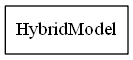

In [48]:
keras.utils.plot_model(model, "multi_input_and_output_model.png", show_shapes=True)

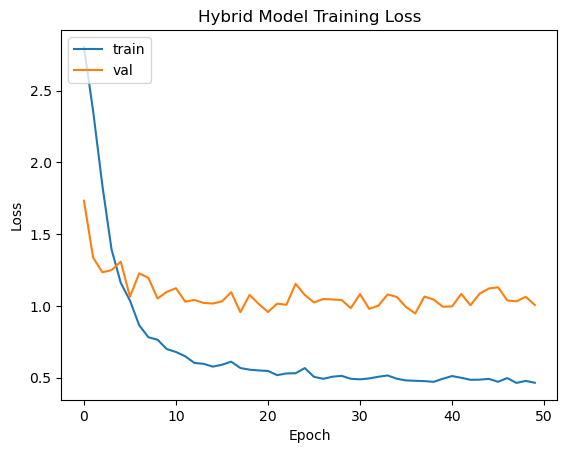

In [49]:
import matplotlib.pyplot as plt
plt.plot(history['loss'])
plt.plot(history['val_loss'])
plt.title('Hybrid Model Training Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['train', 'val'], loc = 'upper left')
plt.show()

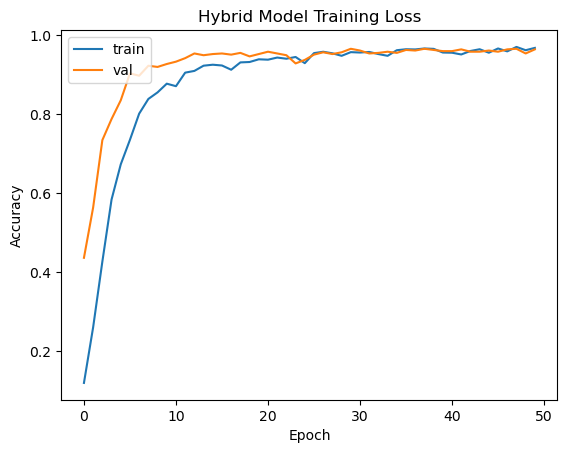

In [50]:
plt.plot(history['accuracy'])
plt.plot(history['val_accuracy'])
plt.title('Hybrid Model Training Loss')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['train', 'val'], loc = 'upper left')
plt.show()

In [55]:
model.evaluate(generator_test)

43/43 [==============================] - 14s 314ms/step - loss: 1.0012 - accuracy: 0.9556


[1.0012067556381226, 0.9555555582046509]

Text(0.5, 1.0, 'Confusion Matrix From Hybrid Model')

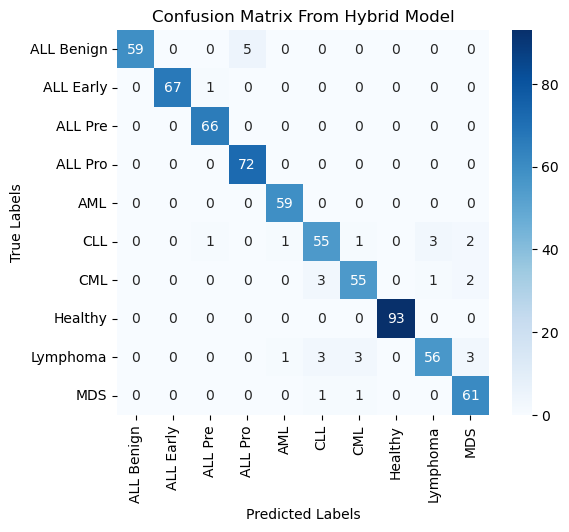

In [56]:
from sklearn.metrics import confusion_matrix
import seaborn as sn
import pandas as pd
import matplotlib.pyplot as plt
y_pred = model.predict(generator_test)
y_pred=np.argmax(y_pred[0],axis=1)
y_test = generator_test.classes

array = confusion_matrix(y_test, y_pred)
df_cm = pd.DataFrame(array, index = ['ALL Benign',
 'ALL Early',
 'ALL Pre',
 'ALL Pro',
 'AML',
 'CLL',
 'CML',
 'Healthy',
 'Lymphoma',
 'MDS'],
                  columns = ['ALL Benign',
 'ALL Early',
 'ALL Pre',
 'ALL Pro',
 'AML',
 'CLL',
 'CML',
 'Healthy',
 'Lymphoma',
 'MDS'])
plt.figure(figsize = (6,5))
cm_plot = sn.heatmap(df_cm, annot=True, cmap='Blues', fmt='g')
cm_plot.set_xlabel('Predicted Labels')
cm_plot.set_ylabel('True Labels')
cm_plot.set_title('Confusion Matrix From Hybrid Model', size=12)

<AxesSubplot:>

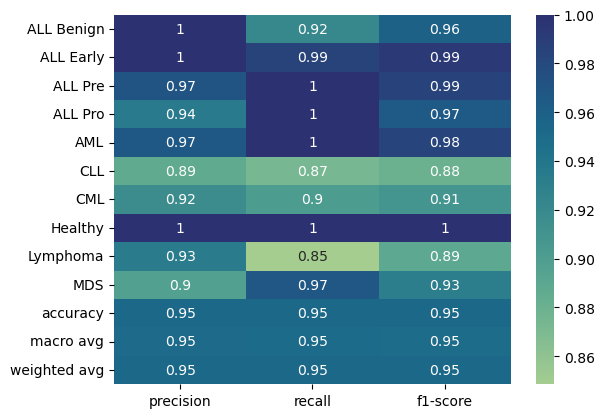

In [57]:
from sklearn.metrics import classification_report
import seaborn as sns
clf_report = classification_report(y_test, y_pred, target_names=['ALL Benign',
 'ALL Early',
 'ALL Pre',
 'ALL Pro',
 'AML',
 'CLL',
 'CML',
 'Healthy',
 'Lymphoma',
 'MDS'], output_dict=True)
sns.heatmap(pd.DataFrame(clf_report).iloc[:-1, :].T, annot=True,  cmap="crest")

ROC AUC score: 0.9723076584117987


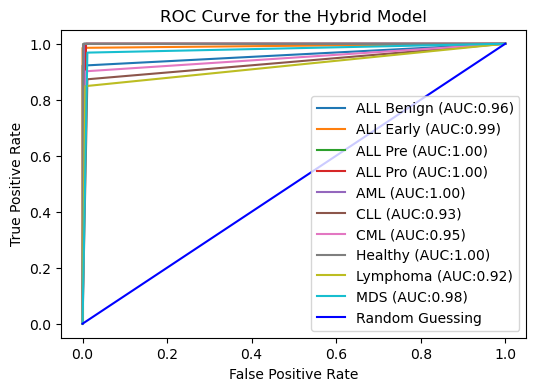

In [58]:
import matplotlib.pyplot as plt 
from sklearn.preprocessing import LabelBinarizer
from sklearn.metrics import roc_curve, auc, roc_auc_score

#y_pred = vit.predict(x_test)
#y_pred=np.argmax(y_pred,axis=1)

target= ['ALL Benign',
 'ALL Early',
 'ALL Pre',
 'ALL Pro',
 'AML',
 'CLL',
 'CML',
 'Healthy',
 'Lymphoma',
 'MDS']

# set plot figure size
fig, c_ax = plt.subplots(1,1, figsize = (6, 4))

# function for scoring roc auc score for multi-class
def multiclass_roc_auc_score(y_test, y_pred, average="macro"):
    lb = LabelBinarizer()
    lb.fit(y_test)
    y_test = lb.transform(y_test)
    y_pred = lb.transform(y_pred)

    for (idx, c_label) in enumerate(target):
        fpr, tpr, thresholds = roc_curve(y_test[:,idx].astype(int), y_pred[:,idx])
        c_ax.plot(fpr, tpr, label = '%s (AUC:%0.2f)'  % (c_label, auc(fpr, tpr)))
    c_ax.plot(fpr, fpr, 'b-', label = 'Random Guessing')
    return roc_auc_score(y_test, y_pred, average=average)


print('ROC AUC score:', multiclass_roc_auc_score(y_test, y_pred))

c_ax.legend()
c_ax.set_xlabel('False Positive Rate')
c_ax.set_ylabel('True Positive Rate')
c_ax.set_title('ROC Curve for the Hybrid Model', size=12)
plt.show()

In [59]:
def plot_stuff(inputs, features_a, features_b, class_name):
    plt.figure(figsize=(50, 50))
    
    plt.subplot(1, 3, 1)
    plt.axis('off')
    plt.imshow(tf.squeeze(inputs/255, axis=0))
    plt.title('Input ('+str(class_name)+')', fontdict = {'fontsize' : 60})
    
    plt.subplot(1, 3, 2)
    plt.axis('off')
    plt.imshow(features_a)
    plt.title('VGG19 ('+str(class_name)+')', fontdict = {'fontsize' : 60})
    
    plt.subplot(1, 3, 3)
    plt.axis('off')
    plt.imshow(features_b)
    plt.title('VGG19+Swin ('+str(class_name)+')', fontdict = {'fontsize' : 60})
    plt.show()

# ref: https://keras.io/examples/vision/grad_cam/
def get_img_array(img):
    array = keras.utils.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    return array

# ref: https://keras.io/examples/vision/grad_cam/
def make_gradcam_heatmap(img_array, grad_model, pred_index=None):
    with tf.GradientTape(persistent=True) as tape:
        preds, base_top, swin_top = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    grads = tape.gradient(class_channel, base_top)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    base_top = base_top[0]
    heatmap_a = base_top @ pooled_grads[..., tf.newaxis]
    heatmap_a = tf.squeeze(heatmap_a)
    heatmap_a = tf.maximum(heatmap_a, 0) / tf.math.reduce_max(heatmap_a)
    heatmap_a = heatmap_a.numpy()

    grads = tape.gradient(class_channel, swin_top)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    swin_top = swin_top[0]
    heatmap_b = swin_top @ pooled_grads[..., tf.newaxis]
    heatmap_b = tf.squeeze(heatmap_b)
    heatmap_b = tf.maximum(heatmap_b, 0) / tf.math.reduce_max(heatmap_b)
    heatmap_b = heatmap_b.numpy()
    return heatmap_a, heatmap_b

In [61]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
grad_dir = "F:/WBC/WBC/grad"

datagen_grad = ImageDataGenerator(rescale=1./255)

generator_grad = datagen_grad.flow_from_directory(directory=grad_dir,
                                                  target_size=(384, 384),
                                                  batch_size=10,
                                                  shuffle=False)

Found 10 images belonging to 10 classes.


(10, 384, 384, 3)
(12, 12) 1.0 0.0
(12, 12) 1.0 0.0


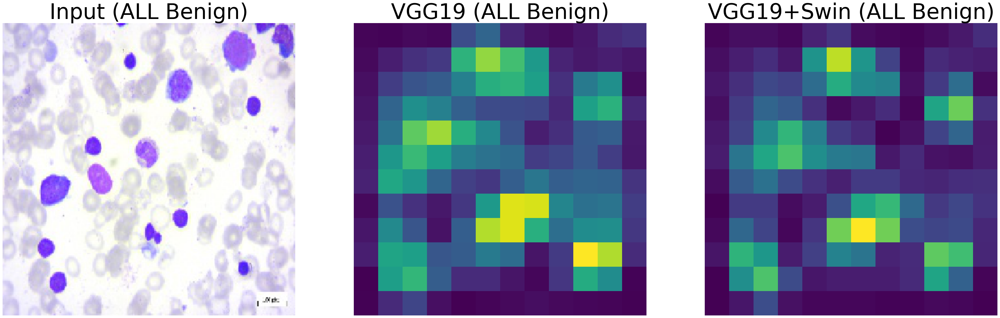

(12, 12) 1.0 0.0
(12, 12) 1.0 0.0


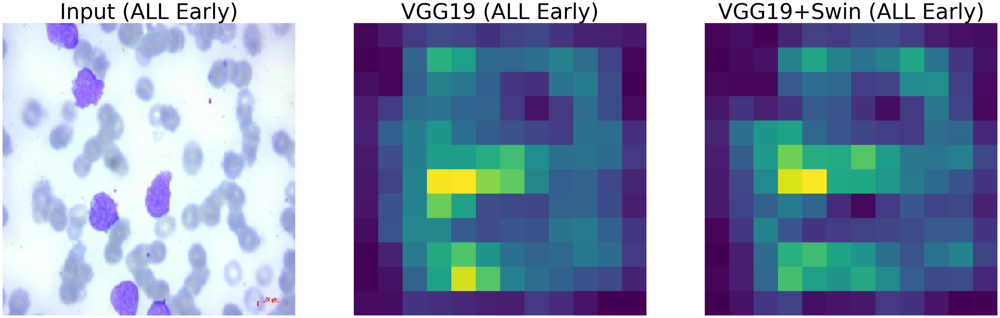

(12, 12) 1.0 0.0
(12, 12) 1.0 0.0


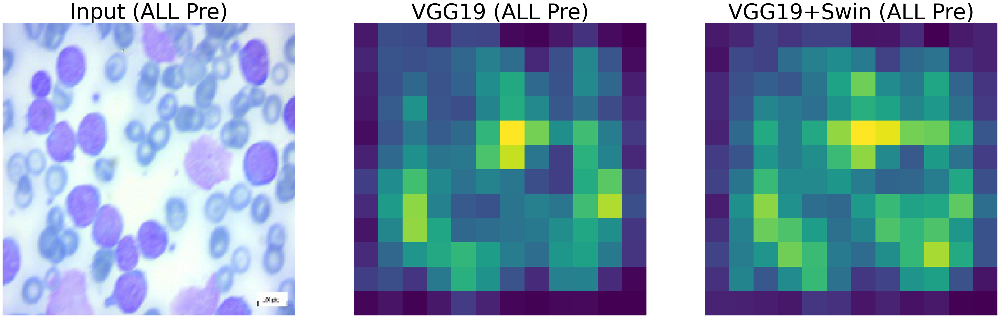

(12, 12) 1.0 0.0
(12, 12) 1.0 0.0


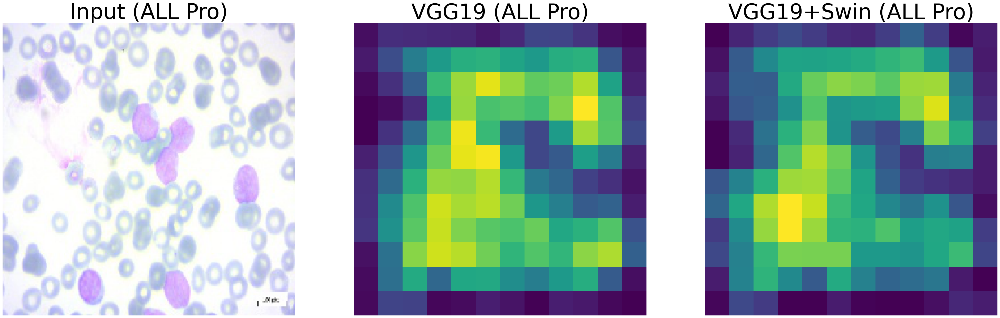

(12, 12) 1.0 0.0
(12, 12) 1.0 0.0


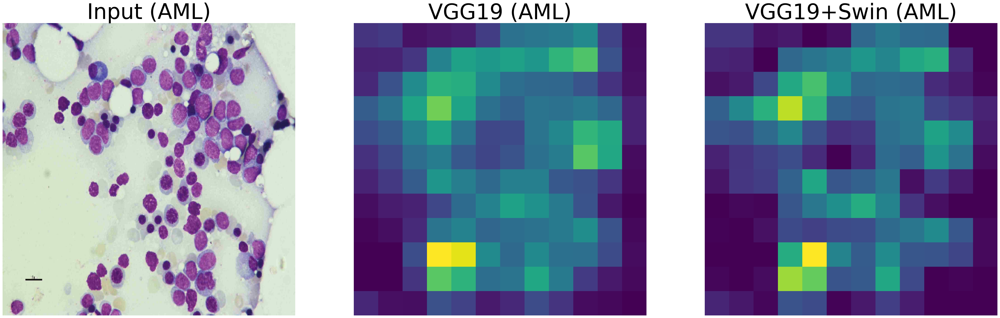

(12, 12) 1.0 0.0
(12, 12) 1.0 0.0


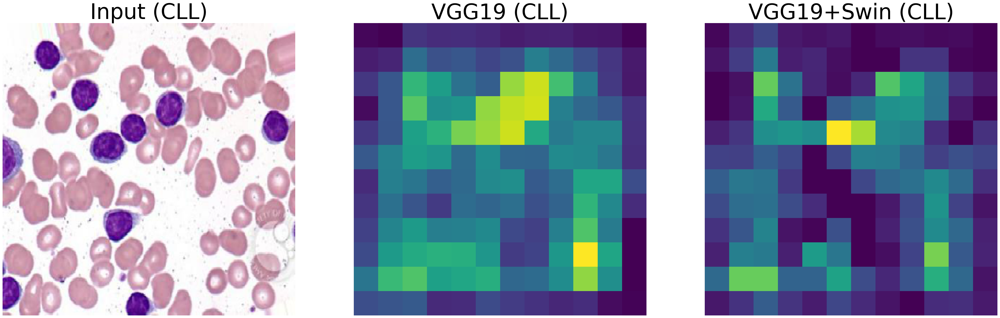

(12, 12) 1.0 0.0
(12, 12) 1.0 0.0


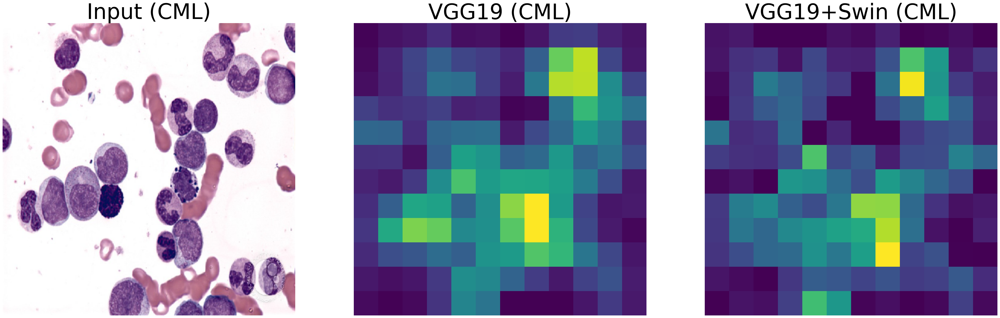

(12, 12) 1.0 0.08325
(12, 12) 1.0 0.08356


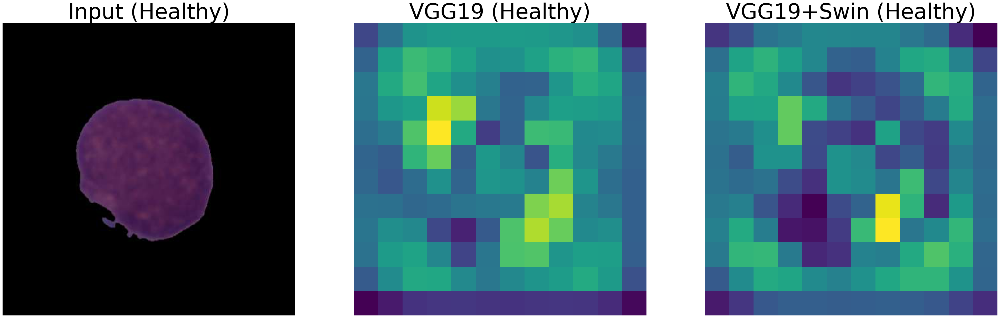

(12, 12) 1.0 0.0
(12, 12) 1.0 0.0


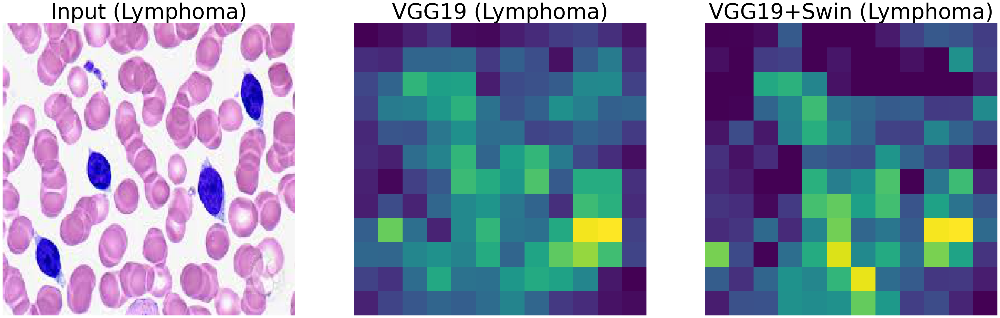

(12, 12) 1.0 0.0
(12, 12) 1.0 0.0


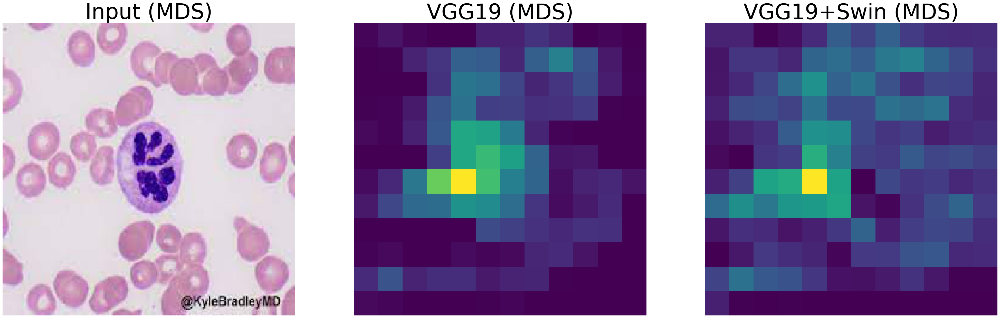

In [62]:
# Get val images
img_arrays = next(iter(generator_grad))[0]
print(img_arrays.shape)
i = 0
# plot utils
for img_array in img_arrays:
    # Generate class activation heatmap
    img_array = get_img_array(img_array)
    cnn_heatmap, swin_heatmap = make_gradcam_heatmap(img_array, model)
    print(cnn_heatmap.shape, cnn_heatmap.max(), cnn_heatmap.min())
    print(swin_heatmap.shape, swin_heatmap.max(), swin_heatmap.min())

    # Display heatmap
    img_array = img_array*255
    plot_stuff(img_array, cnn_heatmap, swin_heatmap, list(generator_grad.class_indices)[i])
    i+=1

In [63]:
def save_and_display_gradcam(
    img,
    heatmap,
    target=None,
    pred=None,
    cam_path="cam.jpg",
    cmap="jet",  # inferno, viridis
    alpha=0.6,
    plot=None,
):
    # Rescale heatmap to a range 0-255
    heatmap = np.uint8(255 * heatmap)

    # Use jet colormap to colorize heatmap
    jet = cm.get_cmap(cmap)

    # Use RGB values of the colormap
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    # Create an image with RGB colorized heatmap
    jet_heatmap = keras.utils.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[0], img.shape[1]))
    jet_heatmap = keras.utils.img_to_array(jet_heatmap)

    # Superimpose the heatmap on original image
    superimposed_img = img*255 + jet_heatmap * alpha
    superimposed_img = keras.utils.array_to_img(superimposed_img)
    return superimposed_img

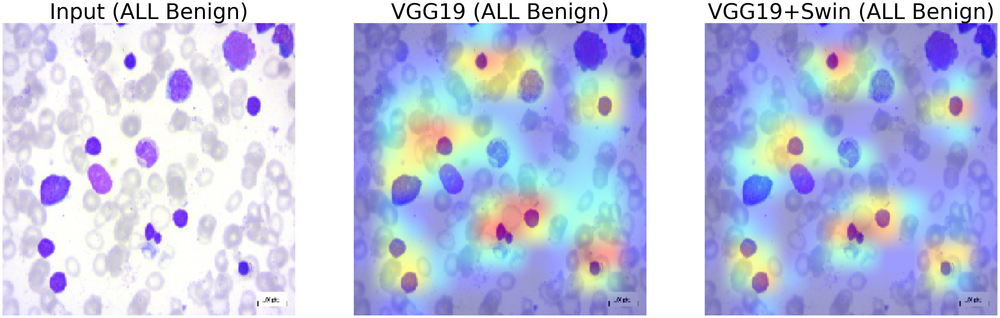

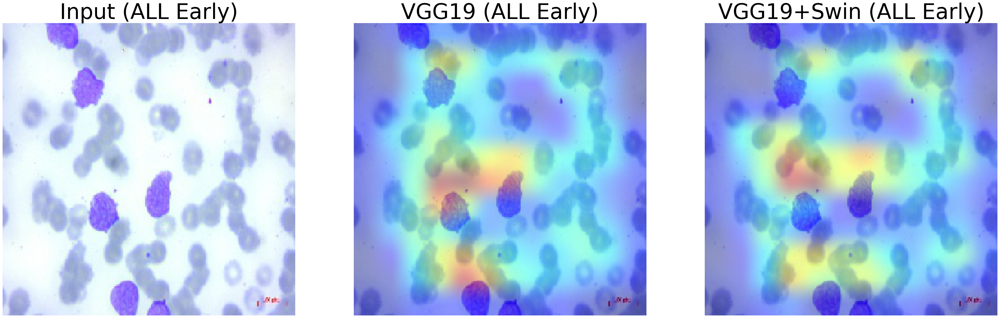

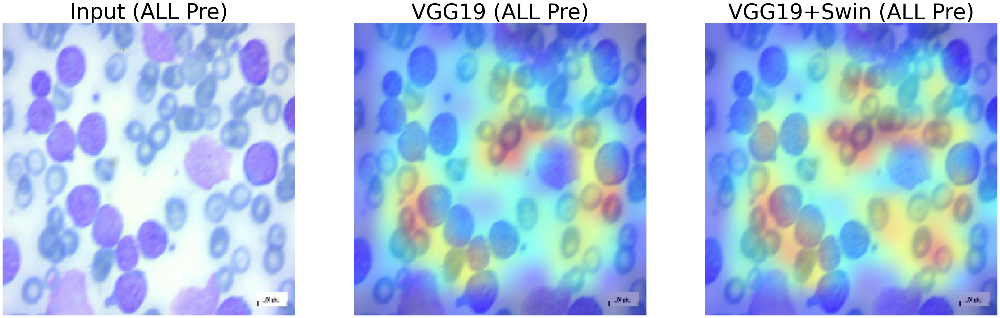

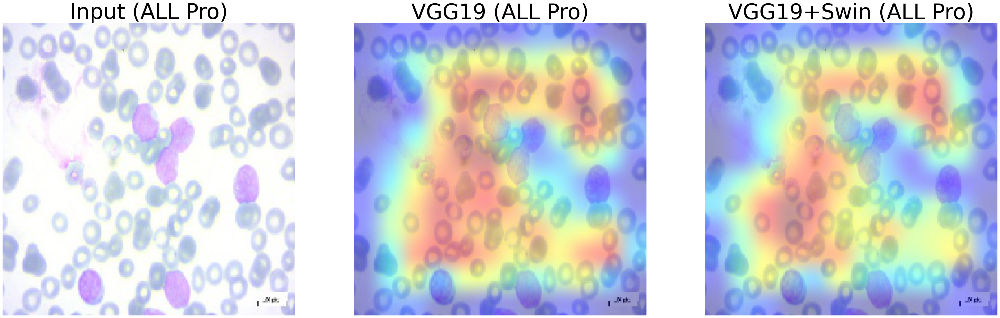

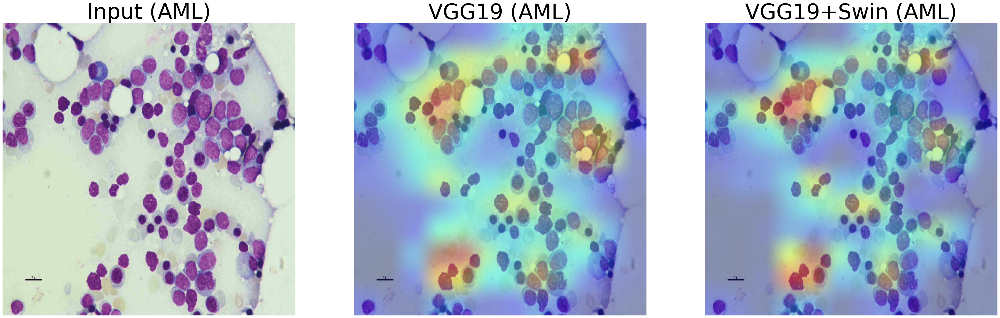

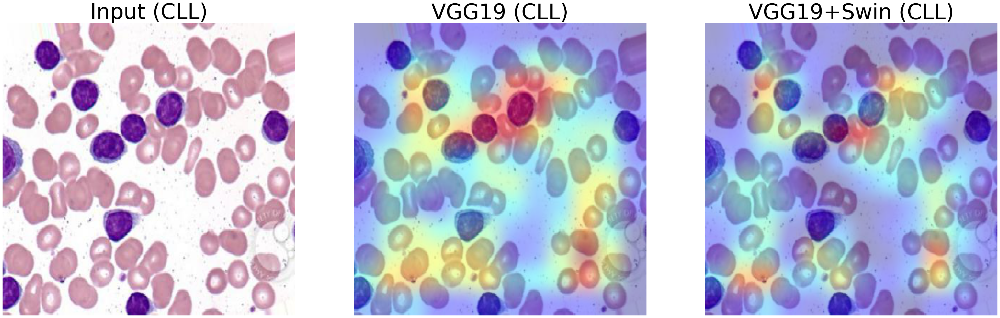

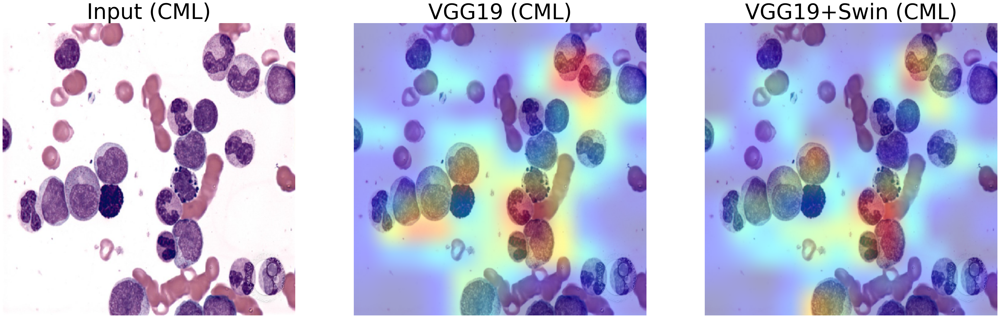

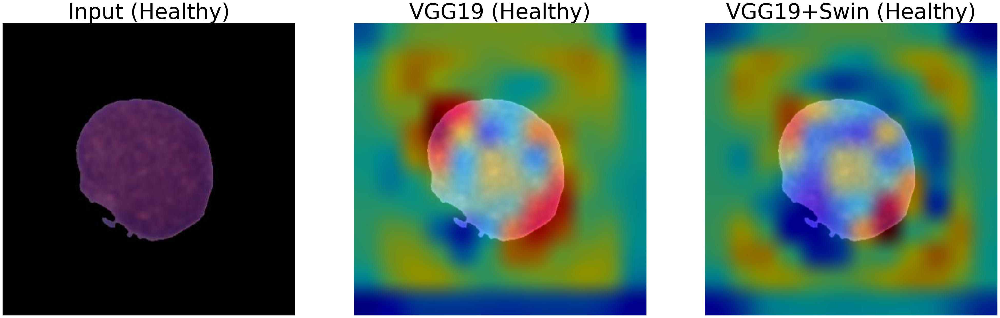

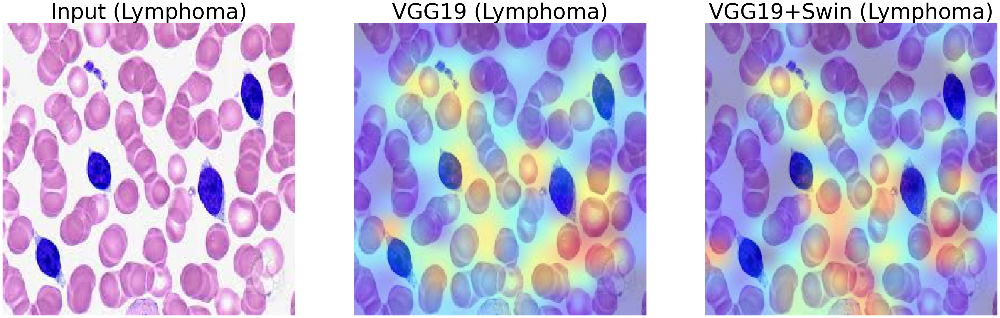

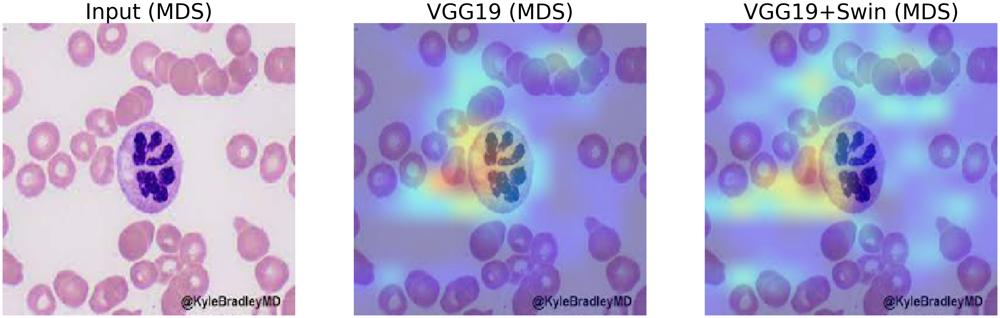

In [64]:

samples, labels = next(iter(generator_grad))
i = 0
for sample, label in zip(samples, labels):
    # preparing
    sample = sample
    img_array = sample[tf.newaxis, ...]

    # get heatmaps
    heatmap_a, heatmap_b = make_gradcam_heatmap(img_array, model)

    # overaly heatmap and input sample
    overaly_a = save_and_display_gradcam(sample, heatmap_a)
    overlay_b = save_and_display_gradcam(sample, heatmap_b)

    # ploting stuff
    plot_stuff(img_array*255, overaly_a, overlay_b, list(generator_grad.class_indices)[i])
    i+=1

In [65]:
model.summary()

Model: "HybridModel"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
VGG19 (Functional)           [(None, 24, 24, 512), (No 20024384  
_________________________________________________________________
conv_head (Sequential)       (None, 512)               0         
_________________________________________________________________
patch_extract (PatchExtract) (None, 144, 2048)         0         
_________________________________________________________________
patch_embedding (PatchEmbedd (None, 144, 64)           140352    
_________________________________________________________________
patch_merging (PatchMerging) ((None, 36, 128), (None,  32768     
_________________________________________________________________
swin_blocks (Sequential)     (None, 144, 64)           33544     
_________________________________________________________________
swin_head (Sequential)       (None, 128)               

In [66]:
import lime
from lime import lime_image
from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt
import random


In [69]:
import importlib
importlib.reload(lime_image)

<module 'lime.lime_image' from 'C:\\Users\\tanzim.reza\\.conda\\envs\\tf_gpu\\lib\\site-packages\\lime\\lime_image.py'>

(384, 384, 3)


100%|██████████| 1000/1000 [00:16<00:00, 62.26it/s]


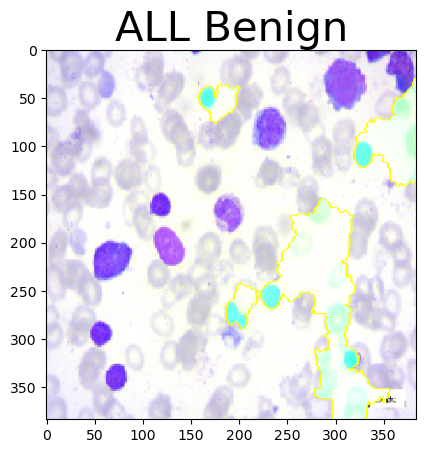

(384, 384, 3)


100%|██████████| 1000/1000 [00:14<00:00, 66.77it/s]


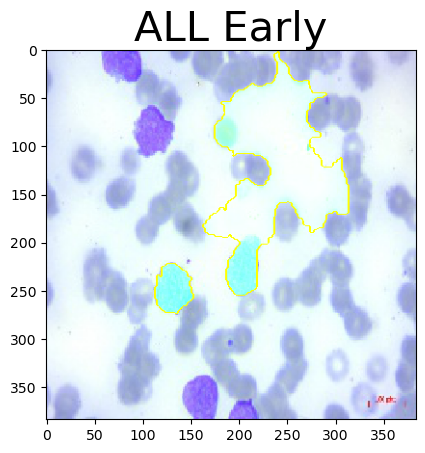

(384, 384, 3)


100%|██████████| 1000/1000 [00:16<00:00, 61.88it/s]


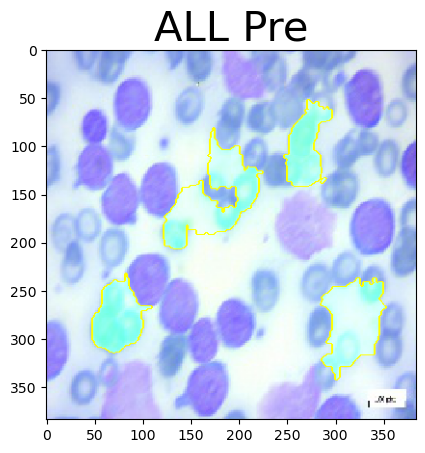

(384, 384, 3)


100%|██████████| 1000/1000 [00:15<00:00, 65.77it/s]


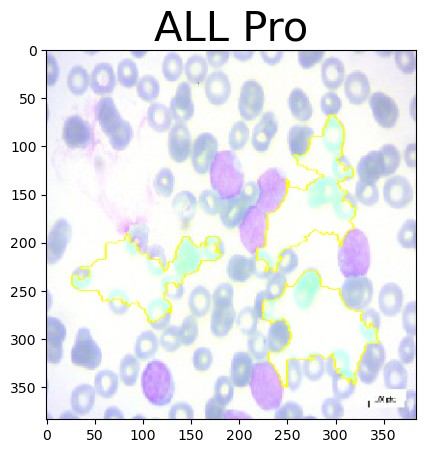

(384, 384, 3)


100%|██████████| 1000/1000 [00:17<00:00, 58.14it/s]


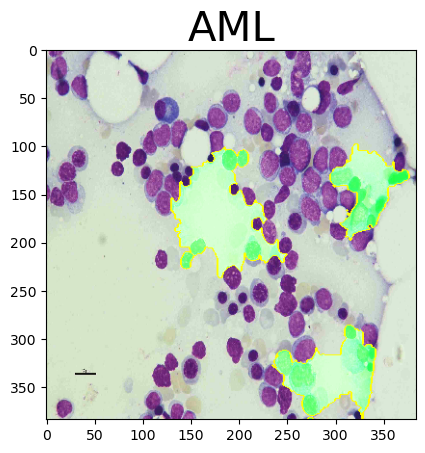

(384, 384, 3)


100%|██████████| 1000/1000 [00:14<00:00, 67.03it/s]


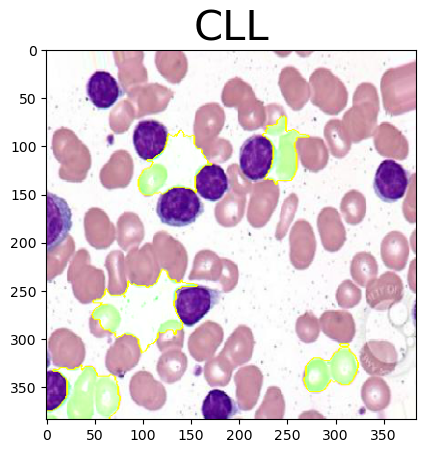

(384, 384, 3)


100%|██████████| 1000/1000 [00:15<00:00, 64.04it/s]


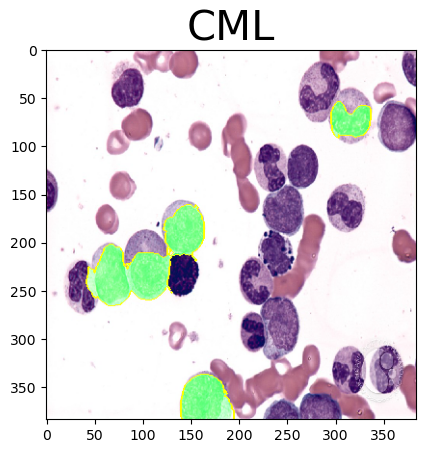

(384, 384, 3)


100%|██████████| 1000/1000 [00:21<00:00, 47.33it/s]


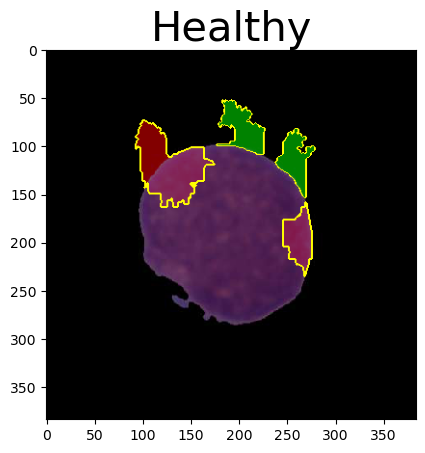

(384, 384, 3)


100%|██████████| 1000/1000 [00:16<00:00, 62.31it/s]


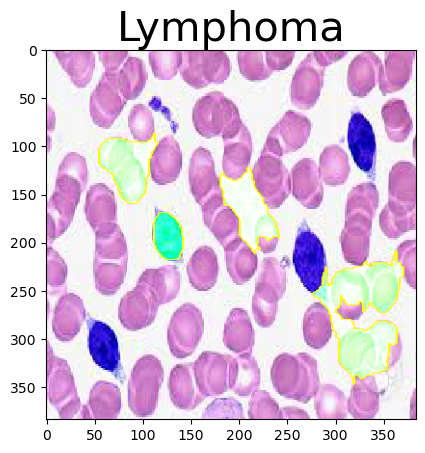

(384, 384, 3)


100%|██████████| 1000/1000 [00:14<00:00, 68.20it/s]


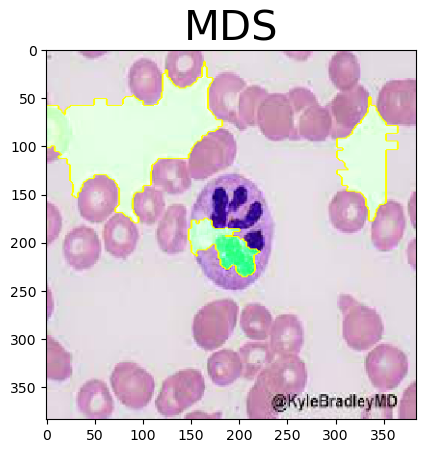

In [70]:
samples, labels = next(iter(generator_grad))
i = 0
for sample, label in zip(samples, labels):
    explainer = lime_image.LimeImageExplainer(random_state=42)
    print(sample.shape)
    explanation = explainer.explain_instance(
             sample, 
             model.predict
    )
    #plt.imshow(x_train[10])
    image, mask = explanation.get_image_and_mask(
             model.predict(
                  sample.reshape((1,384,384,3))
             )[0].argmax(axis=1)[0],
             positive_only=False, 
             hide_rest=False)
    plt.imshow(mark_boundaries(image, mask))
    plt.title(str(list(generator_grad.class_indices)[i]), fontdict = {'fontsize' : 30})
    i+=1
    plt.show()

In [34]:
for sample, label in zip(samples, labels):
    print(sample.shape)
    yy = model(sample.reshape(1,384,384,3))[0]
    print(yy.shape)
    break

(384, 384, 3)
(1, 10)


In [35]:
len(y_pred)

675

In [45]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
grad_dir = "F:/WBC/WBC/grad"

datagen_grad = ImageDataGenerator(rescale=1./255)

generator_grad = datagen_grad.flow_from_directory(directory=grad_dir,
                                                  target_size=(384, 384),
                                                  batch_size=10,
                                                  shuffle=False)

Found 10 images belonging to 10 classes.


In [37]:
generator_grad.class_indices

{'ALL Benign': 0,
 'ALL Early': 1,
 'ALL Pre': 2,
 'ALL Pro': 3,
 'AML': 4,
 'CLL': 5,
 'CML': 6,
 'Healthy': 7,
 'Lymphoma': 8,
 'MDS': 9}

In [38]:
for sample, label in zip(samples, labels):
    print(np.argmax(label))

0
1
2
3
4
5
6
7
8
9


In [58]:
for key in generator_grad.class_indices:
    print(key)

ALL Benign
ALL Early
ALL Pre
ALL Pro
AML
CLL
CML
Healthy
Lymphoma
MDS
